In [1]:
from calimba.analysis.utilities import add_folder_to_path

add_folder_to_path('/home/anleg84/GitHub/Calimba/')

from utilities import *
from data import *
from atlas import *
from networks import *
from behavior import *
from timeseries import *
from visualization import *

from useful_functions import *

%matplotlib inline
plt.rcParams['font.size'] = 18

/home/anleg84/anaconda3/envs/calimba/lib/python3.9/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)


# Setting paths

In [2]:
top_directory = '/media/anleg84/One Touch/Data/Main/'
atlas_path = '/home/anleg84/Documents/Atlas/Mapzebrain/'
directories = identify_folders(top_directory, ['dpf'])

In [3]:
datasets = get_datasets(top_directory, ['920nm', 'wholebrain'])

In [4]:
excluded = [10, 34, 44, 49, 69]

In [5]:
atlas = MapzebrainAtlas(atlas_path)
acronyms = list(np.delete(atlas.acronyms, excluded))

In [6]:
SC = delete_rows_and_columns(atlas.undirected, excluded)

# Loading data

In [7]:
folder = datasets[11]

In [8]:
folder

'/media/anleg84/One Touch/Data/Main/20230731-Wholebrain-5dpf/20230731_10_00_19_920nm_5dpf_fish1_wholebrain/'

In [9]:
timeseries = np.delete(np.load(folder + 'region_series_dff.npy'), excluded, axis=0)
data = load_data(folder)

# Generating figure

In [10]:
ratio = data['average_frames'].shape[1] / data['average_frames'].shape[0]

In [11]:
palette = generate_n_colors(11, saturation=65, value=90)
palette *= 6

In [12]:
ratio = data['average_frames'].shape[1] / data['average_frames'].shape[2]

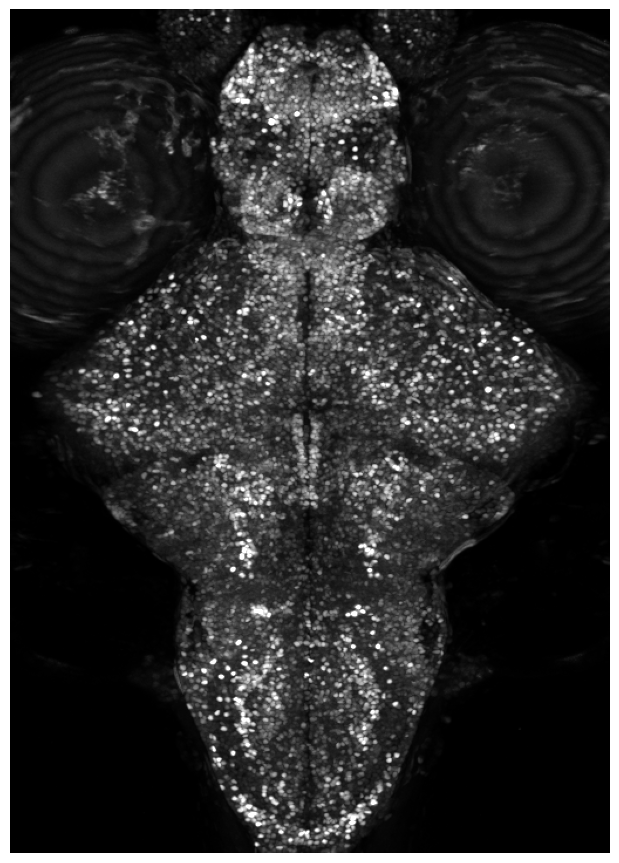

In [13]:
plt.figure(figsize=(6, 6 * ratio))
plt.imshow(np.max(data['average_frames'], axis=0), cmap='gray', vmax=35000)
centroids = np.copy(data['centroids'])
#centroids = np.delete(centroids, data['region_labels'][:, 10] != 0, axis=0)
#plt.scatter(centroids[:, 1], centroids[:, 0], edgecolor='none', marker='.', color='red', alpha=0.1)

#labels = np.delete(data['region_labels'], excluded, axis=1)
#for i in range(labels.shape[1]):
#    plt.scatter(centroids[labels[:, i] != 0, 1], centroids[labels[:, i] != 0, 0], edgecolor='none', marker='.', color='red', alpha=0.2)

plt.axis('off')
plt.tight_layout(pad=0)
plt.savefig('Figures/figure1_topprojection.png')

In [14]:
ratio = data['average_frames'].shape[1] / data['average_frames'].shape[0] / 7

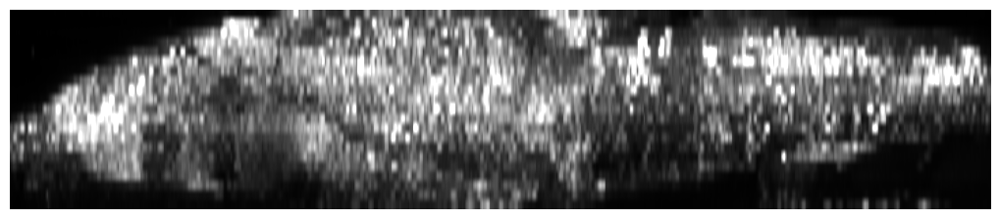

In [15]:
plt.figure(figsize=(10, 10 / ratio))
plt.imshow(np.max(data['average_frames'], axis=2), cmap='gray', vmax=35000, aspect=7)
#centroids = data['centroids']
#labels = np.delete(data['region_labels'], excluded, axis=1)
#for i in range(labels.shape[1]):
#    plt.scatter(centroids[labels[:, i] != 0, 1], centroids[labels[:, i] != 0, 0], edgecolor='none', marker='.', color='red', alpha=0.2)

plt.axis('off')
plt.tight_layout(pad=0)
plt.savefig('Figures/figure1_sideprojection.png')

In [16]:
for i in range(data['average_frames'].shape[0]):
    save_stack('Figures/figure1_plane{}.tif'.format(i), data['average_frames'][i])

# Projecting centroids

In [17]:
projection_top = np.load('Results/projection_regions_top.npy')

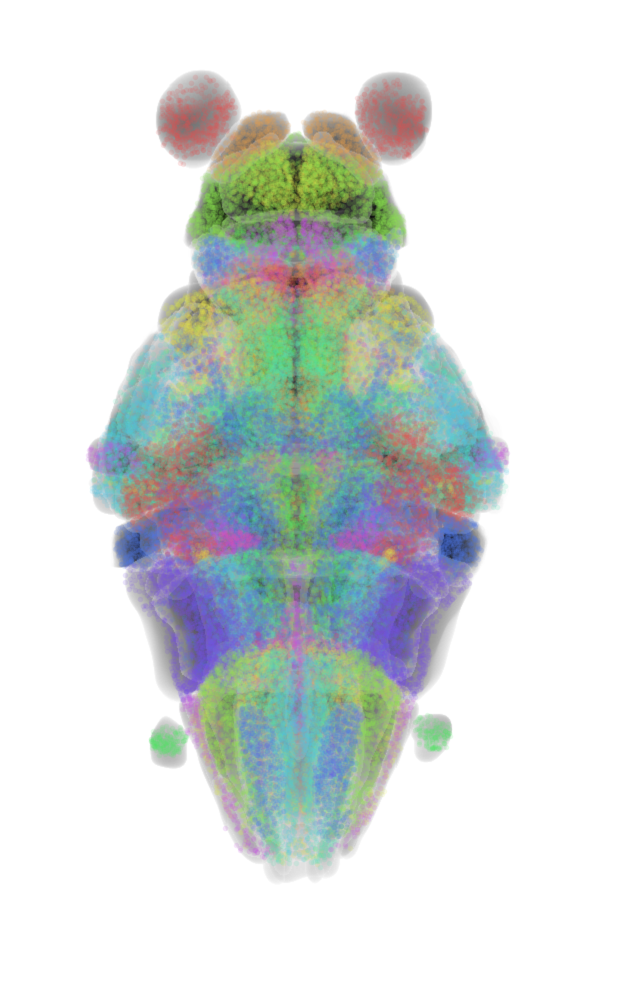

In [19]:
ratio = 974 / 597

plt.figure(figsize=(6, 6 * ratio), dpi=300)
plt.imshow(projection_top, cmap='binary')
centroids = data['centroids_atlas']
labels = np.delete(np.copy(data['region_labels']), excluded, axis=1)
for i in range(labels.shape[1]):
    plt.scatter(centroids[labels[:, i] != 0, 0], centroids[labels[:, i] != 0, 1], marker='.', color=palette[i], edgecolor='none', alpha=0.15)
plt.axis('off')
plt.savefig('Figures/figure1_atlascentroids_top.png')

In [20]:
projection_side = np.load('Results/projection_regions_side.npy')

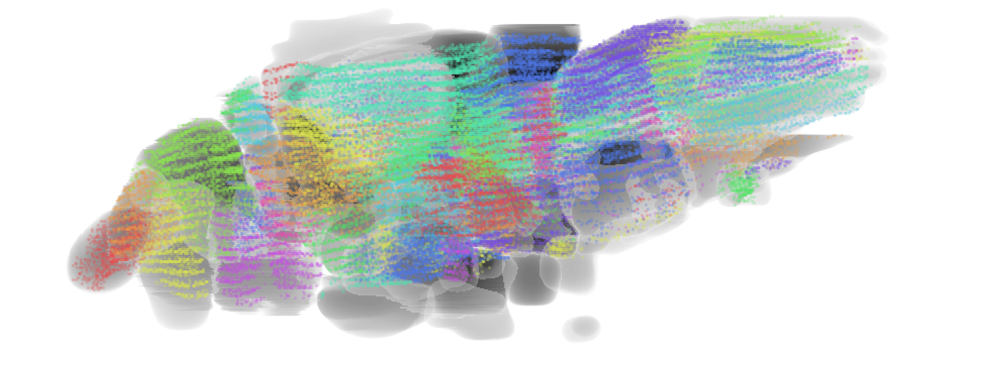

In [21]:
ratio = 974 / 359

plt.figure(figsize=(6 * ratio, 6 ), dpi=300)
plt.imshow(projection_side, cmap='binary')
centroids = data['centroids_atlas']
labels = np.delete(np.copy(data['region_labels']), excluded, axis=1)
for i in range(labels.shape[1]):
    plt.scatter(centroids[labels[:, i] != 0, 1], centroids[labels[:, i] != 0, 2], marker='.', color=palette[i], edgecolor='none', alpha=0.25)
plt.axis('off')
plt.savefig('Figures/figure1_atlascentroids_side.png')

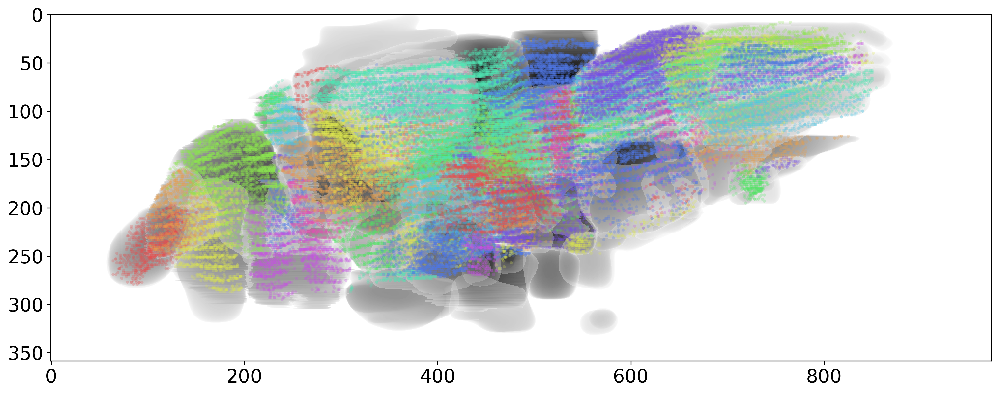

In [22]:
ratio = 974 / 359

plt.figure(figsize=(6 * ratio, 6 ), dpi=300)
plt.imshow(projection_side, cmap='binary')
centroids = data['centroids_atlas']
labels = np.delete(np.copy(data['region_labels']), excluded, axis=1)
for i in range(labels.shape[1]):
    plt.scatter(centroids[labels[:, i] != 0, 1], centroids[labels[:, i] != 0, 2], marker='.', color=palette[i], edgecolor='none', alpha=0.25)
#plt.axis('off')
plt.savefig('Figures/figure1_atlascentroids_side_axison.png')

# Region time series

In [108]:
folder = datasets[11]
timeseries = np.delete(np.load(folder + 'region_series_dff.npy'), excluded, axis=0)

In [109]:
ratio = 84 / 72

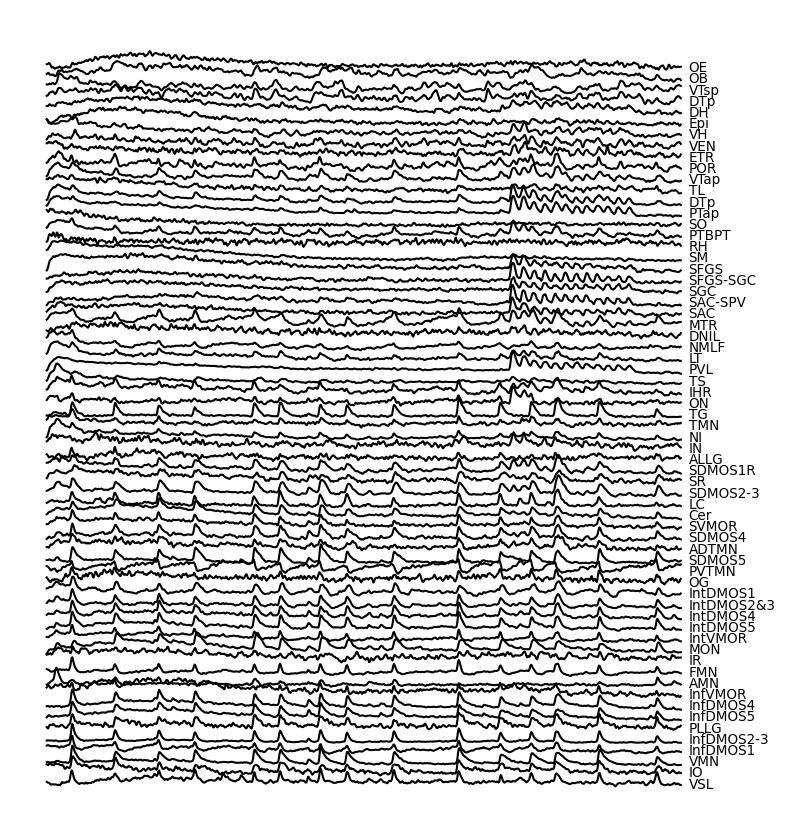

In [110]:
fig, ax = plt.subplots(figsize=(6, 6 * ratio), dpi=150)
z = 0
for i in range(timeseries.shape[0]):
    plt.plot(gaussian_filter1d(normalize(timeseries[i]), 1) - 0.5 * z, color='black', linewidth=1)
    z += 1
z = 0
for i in range(timeseries.shape[0]):
    plt.text(timeseries.shape[1] + 10, - 0.5 * z, acronyms[i], fontsize=6.5)
    z += 1

plt.axis('off')
plt.savefig('Figures/figure1_region_timeseries.svg')

# Plotting network

In [12]:
FC = np.load('Results/FC_matrix.npy')

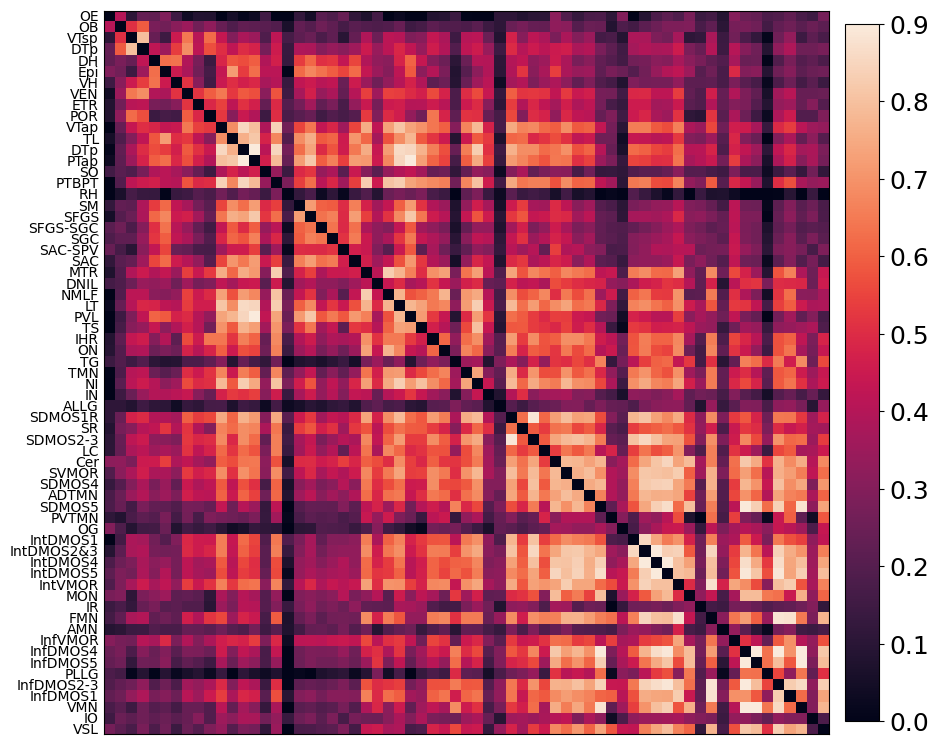

In [13]:
fig, ax = plt.subplots(figsize=(10, 10))
cax = plt.imshow(FC, cmap='rocket', vmin=0, vmax=0.9)
#cbar = fig.colorbar(cax, ax=ax, fraction=0.04, pad=0.02)
plt.colorbar(cax, ax=ax, fraction=0.045, pad=0.02)

ylim = plt.ylim()

for i in range(65):
    plt.text(-1, i, acronyms[i], ha='right', va='center', fontsize=10)
    
plt.xticks([])
plt.yticks([])
plt.ylim([64.4, -0.5])
plt.savefig('Figures/figure1_FC_text.svg')

plt.show()

In [14]:
FC_bilat = np.tile(FC, (2, 2))

In [15]:
region_centroids = np.concatenate([atlas.regionCentroids['left'], atlas.regionCentroids['right']], axis=0)
region_centroids[:, 1] = 974 - region_centroids[:, 1]
region_centroids = np.delete(region_centroids, np.concatenate([excluded, np.array(excluded) + 70]), axis=0)

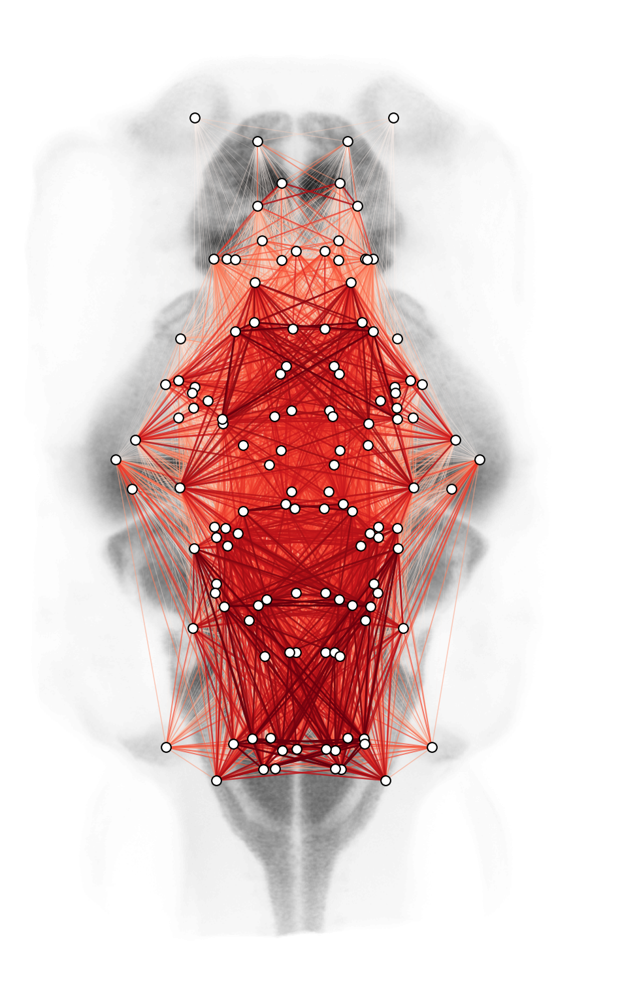

In [16]:
percentile = 50

ratio = atlas.XYprojection.shape[0] / atlas.XZprojection.shape[1]
fig, ax = plt.subplots(figsize=(10, 10 * ratio), dpi=150)
plt.imshow(atlas.XYprojection, cmap='binary')
draw_graph(ax, FC_bilat, region_centroids, percentile=0, s=50, edge_cmap='Reds', alpha=1, edge_vmin=0.3, edge_vmax=0.9)

plt.axis('off')
plt.tight_layout(pad=0)
plt.savefig('Figures/figure1_network_top_binary.png')

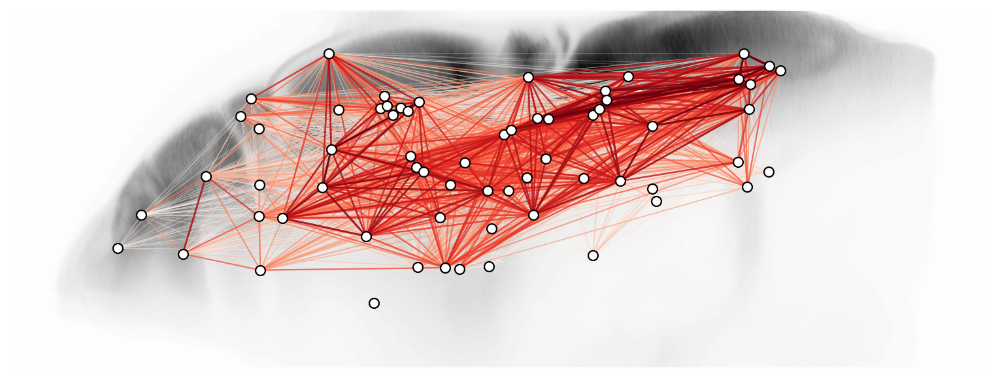

In [17]:
percentile = 50

ratio = atlas.XZprojection.shape[0] / atlas.XZprojection.shape[1]
fig, ax = plt.subplots(figsize=(10, 10 * ratio), dpi=150)
plt.imshow(atlas.XZprojection, cmap='binary', vmin=0)
draw_graph(ax, FC_bilat, np.delete(region_centroids, 0, axis=1), percentile=0, s=50, edge_cmap='Reds', alpha=0.5, edge_vmin=0.3, edge_vmax=0.9)
plt.axis('off')
plt.tight_layout(pad=0)

plt.savefig('Figures/figure1_network_side_binary.png')

In [18]:
np.sum(FC[np.triu_indices(65, 1)] > 0) / len(FC[np.triu_indices(65, 1)])

0.9903846153846154

# Comparing networks across fishies

In [18]:
def get_correlation_matrices(timeseries_list):
    corr_matrices = []
    for i in range(len(timeseries_list)):
        matrix = compute_correlation_matrix(timeseries_list[i])
        matrix[np.isnan(matrix)] = 0
        corr_matrices.append(matrix)
    return corr_matrices

def remove_global_signal(timeseries):
    global_signal = np.mean(timeseries, axis=0)
    regressed = np.zeros(timeseries.shape)
    for i in range(timeseries.shape[0]):
        _, fit = fit_signal(global_signal, timeseries[i])
        regressed[i] = timeseries[i] - fit.flatten()
    return regressed

In [19]:
sigma = 2

rseries = []
for ds in datasets:
    
    rseries.append((np.load(ds + 'region_series_dff.npy')[:, :600]))
    rseries[-1] = np.delete(rseries[-1], excluded, axis=0)
    for i in range(rseries[-1].shape[0]):
        rseries[-1][i] = gaussian_filter1d(rseries[-1][i], sigma)

In [20]:
corr_matrices = get_correlation_matrices(rseries)

In [21]:
matrices = np.stack(corr_matrices, axis=0)

In [22]:
fish_correlations = correlate_matrices(corr_matrices, corr_matrices)
order = np.flip(np.argsort(np.mean(fish_correlations, axis=1)))
fish_correlations = correlate_matrices(list(np.array(corr_matrices)[order]),
                                       list(np.array(corr_matrices)[order]))

In [23]:
fish_ids = []
for i in range(22):
    fish_ids.append('Fish {}'.format(i + 1))
fish_ids = np.array(fish_ids)

In [27]:
np.save('Data/figure1_fish_ids.npy', fish_ids[order])
np.save('Data/figure1_fish_correlations.npy', fish_correlations)

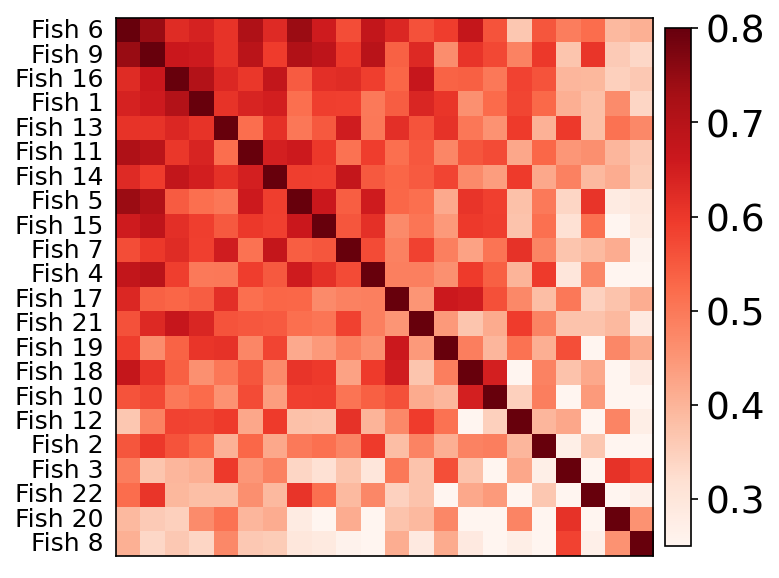

In [24]:
fig, ax = plt.subplots(figsize=(5, 5), dpi=150)

cax = ax.imshow(fish_correlations, cmap='Reds', vmin=0.25, vmax=0.8)
for i in range(len(fish_ids)):
    plt.text(-1, i, fish_ids[order][i], ha='right', va='center', fontsize=12)
plt.xticks([])
plt.yticks([])

plt.colorbar(cax, ax=ax, fraction=0.045, pad=0.02)
plt.tight_layout(pad=0)
#plt.savefig('Figures/figure1_fish_similarity.svg')
plt.show()

In [39]:
np.mean(fish_correlations[np.triu_indices(22, 1)])

0.4911257927260141

(0.0, 1.0)

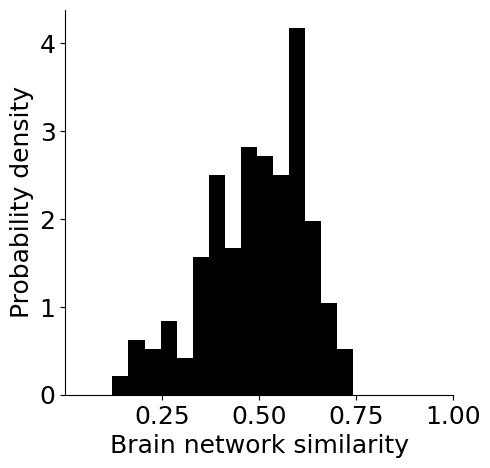

In [40]:
fig, ax = plt.subplots(figsize=(5, 5))
ax.hist(fish_correlations[np.triu_indices(22, 1)], bins=15, color='black', density=True)
ax.spines[['top', 'right']].set_visible(False)
plt.xlabel('Brain network similarity')
plt.ylabel('Probability density')
plt.xticks([0.25, 0.5, 0.75, 1])
plt.xlim([0, 1])

In [41]:
corr_matrices = list(np.array(corr_matrices)[order])

In [42]:
def get_correlation_matrices(timeseries_list):
    corr_matrices = []
    for i in range(len(timeseries_list)):
        matrix = compute_correlation_matrix(timeseries_list[i])
        matrix[np.isnan(matrix)] = 0
        corr_matrices.append(matrix)
    return corr_matrices

In [43]:
random_correlation_values = []
for _ in tqdm(range(100), file=sys.stdout):
    random_rseries = []
    for ts in rseries:
        random_ts = shuffle_signal_phases(ts)
        random_rseries.append(random_ts)
    random_matrices = get_correlation_matrices(random_rseries)
    random_correlations = correlate_matrices(random_matrices, random_matrices)
    random_correlation_values.append(random_correlations[np.triu_indices(22, 1)])

100%|█████████████████████████████████████████| 100/100 [00:35<00:00,  2.82it/s]


(0.0, 1.0)

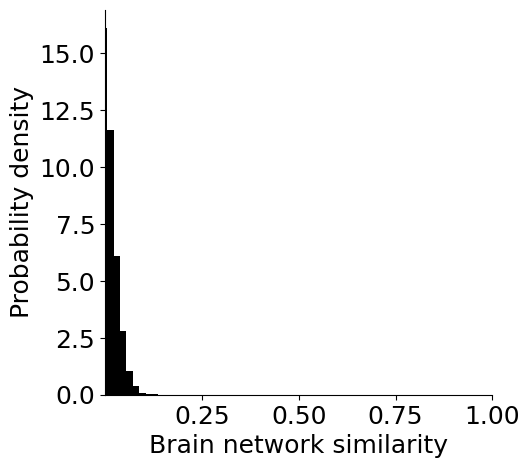

In [44]:
fig, ax = plt.subplots(figsize=(5, 5))
ax.hist(np.concatenate(random_correlation_values), bins=15, color='black', density=True)
ax.spines[['top', 'right']].set_visible(False)
plt.xlabel('Brain network similarity')
plt.ylabel('Probability density')
plt.xticks([0.25, 0.5, 0.75, 1])
plt.xlim([0, 1])

#### Null model

In [45]:
def block_shuffle(time_series, block_size):
    
    assert block_size > 0, "Block size must be positive"
    assert block_size < len(time_series), "Block size must be smaller than time series length"

    num_blocks = len(time_series) // block_size
    blocks = [time_series[i:i+block_size] for i in range(0, len(time_series), block_size)]
    np.random.shuffle(blocks)
    shuffled_series = np.concatenate(blocks)

    return shuffled_series

def shuffle_timeseries(timeseries, block_size):
    shuffled = np.zeros(timeseries.shape)
    for i in range(timeseries.shape[0]):
        shuffled[i] = block_shuffle(timeseries[i], block_size)
    return shuffled

def shuffle_corr_matrix(corr_matrix):
    c = corr_matrix
    r = np.zeros(c.shape)
    values = c[np.triu_indices(c.shape[0], 1)]
    np.random.shuffle(values)
    r[np.triu_indices(c.shape[0], 1)] = values
    r = r.T
    r[np.triu_indices(c.shape[0], 1)] = values
    return r

def shuffle_matrix_eigvals(matrix):
    M = matrix
    eigvals, V = np.linalg.eig(M)
    L = np.zeros(V.shape)
    np.random.shuffle(eigvals)
    L[np.diag_indices(L.shape[0])] = eigvals
    reconstructed = V @ L @ V.T
    return reconstructed

def shuffle_matrix_eigvecs(matrix):
    M = matrix
    eigvals, V = np.linalg.eig(M)
    L = np.zeros(V.shape)
    L[np.diag_indices(L.shape[0])] = eigvals

    for i in range(V.shape[1]):
        id = int(np.random.uniform(0, V.shape[0]))
        V[:, i] = np.concatenate([V[id:, i], V[:id, i]])
    reconstructed = V @ L @ V.T
    return reconstructed

#### Model 1: Spatial shuffling of matrix eigenvectors

In [46]:
random_correlation_values1 = []
for _ in tqdm(range(100), file=sys.stdout):
    random_matrices = []
    for c in corr_matrices:
        random_matrices.append(shuffle_matrix_eigvecs(c))
    random_correlations = correlate_matrices(random_matrices, random_matrices)
    random_correlation_values1.append(random_correlations[np.triu_indices(22, 1)])

100%|█████████████████████████████████████████| 100/100 [00:20<00:00,  4.85it/s]


/tmp/ipykernel_20055/1131479557.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2, figsize=(10, 5))


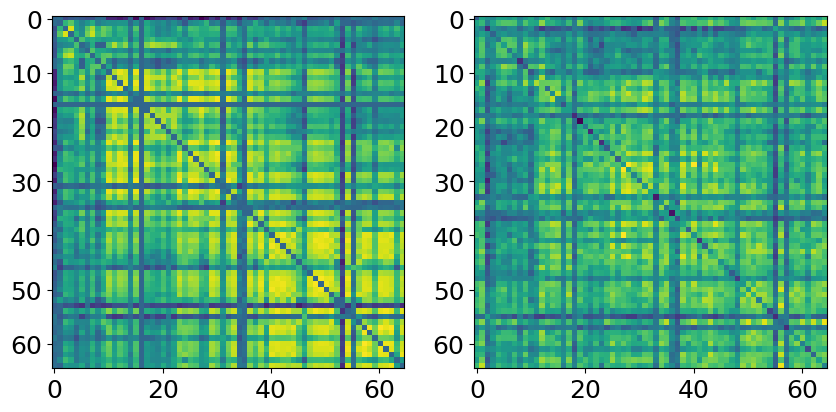

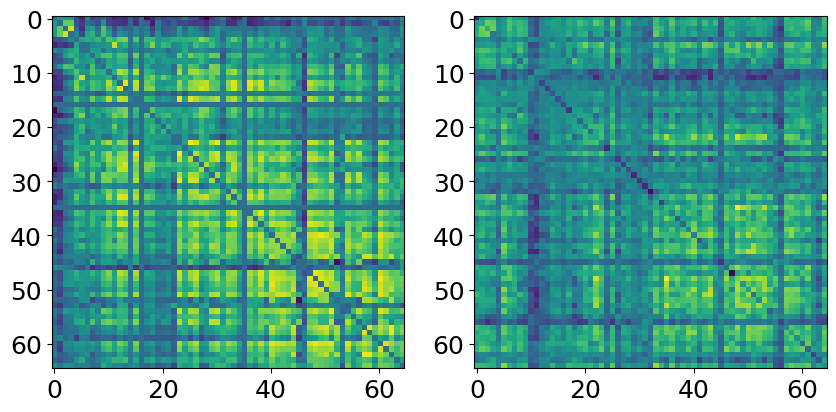

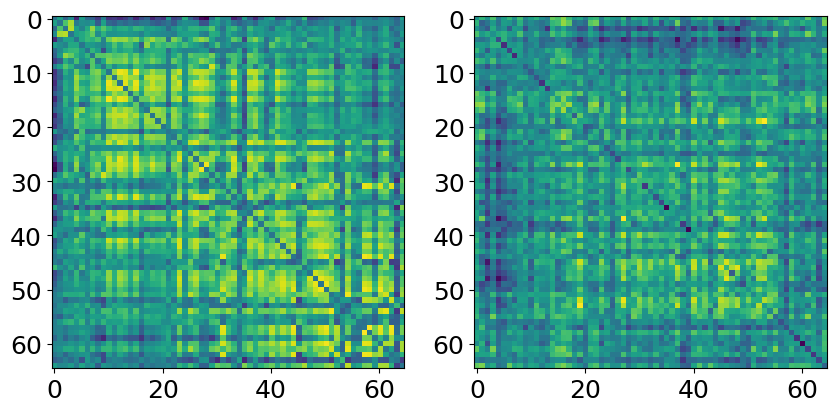

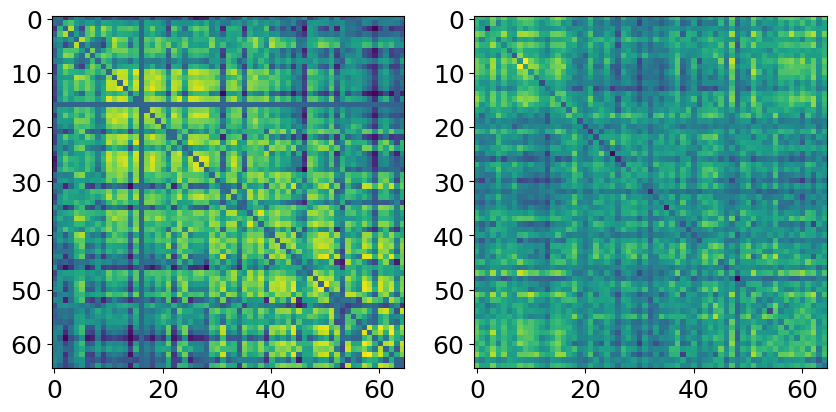

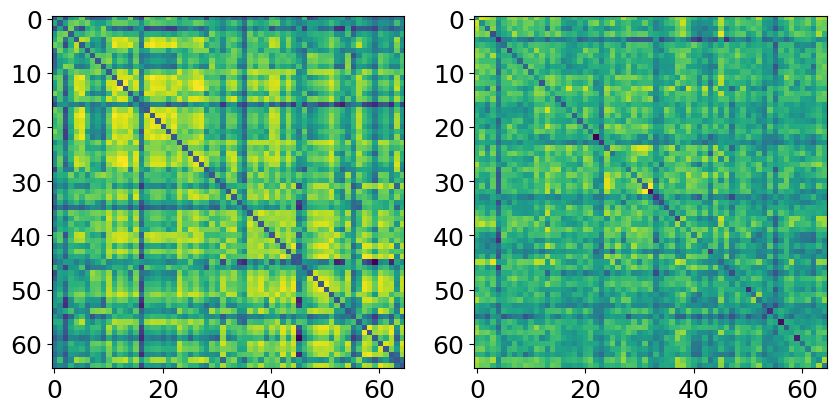

...

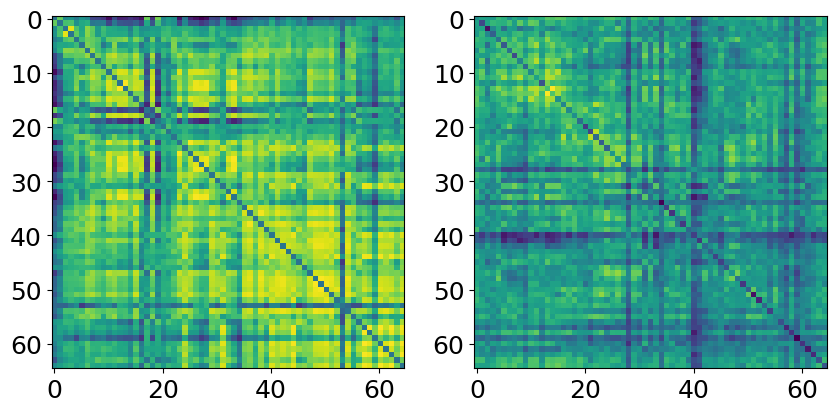

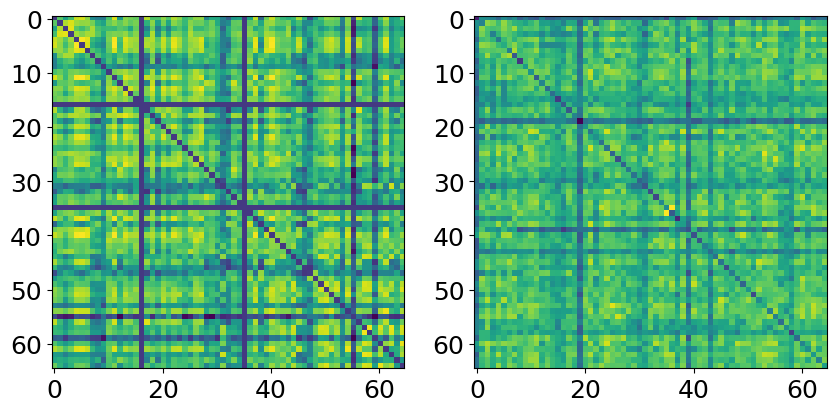

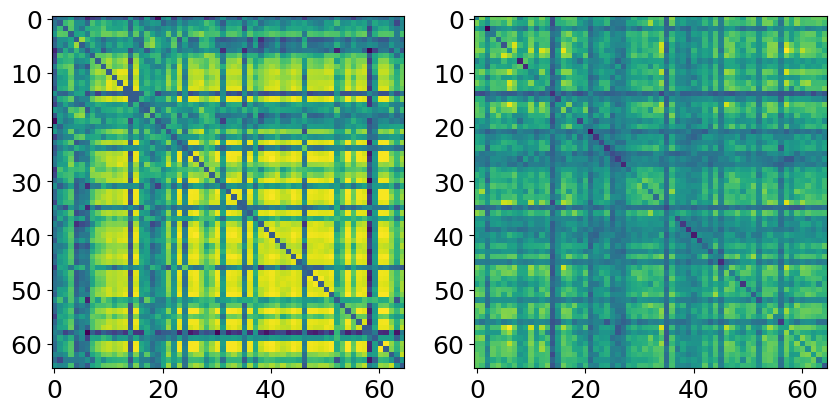

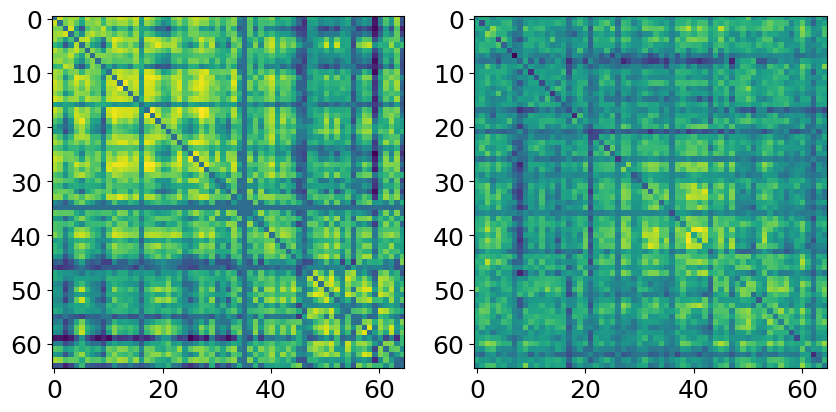

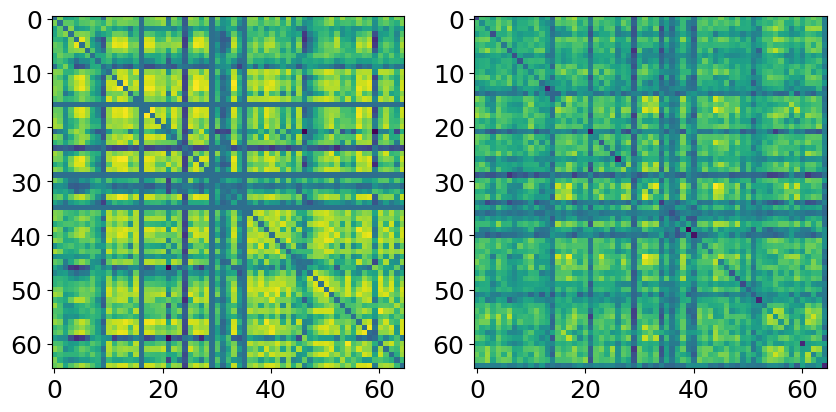

In [47]:
for i in range(len(random_matrices)):
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(corr_matrices[i])
    ax[1].imshow(random_matrices[i])

#### Model 2: Temporal shuffling of timeseries

In [48]:
block_size = 60
random_correlation_values2 = []

for _ in range(1):
    random_timeseries, random_matrices = [], []
    for r in rseries:
        random_timeseries.append(shuffle_timeseries(r, block_size))
    random_matrices = get_correlation_matrices(random_timeseries)
    random_correlations = correlate_matrices(random_matrices, random_matrices)
    
    random_correlation_values2.append(random_correlations[np.triu_indices(22, 1)])

/tmp/ipykernel_20055/1131479557.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2, figsize=(10, 5))


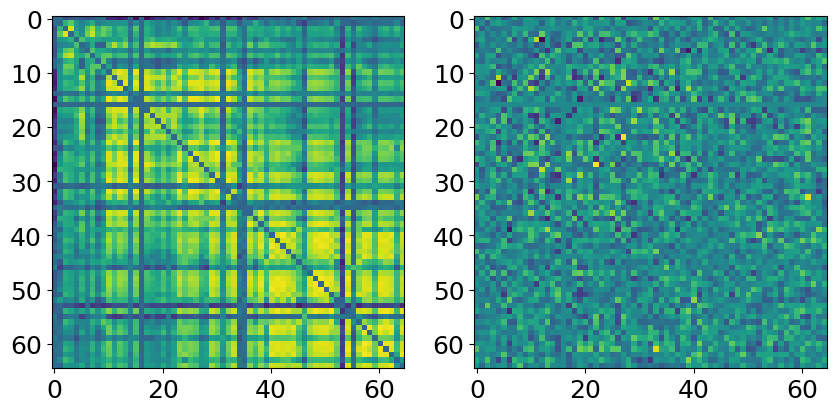

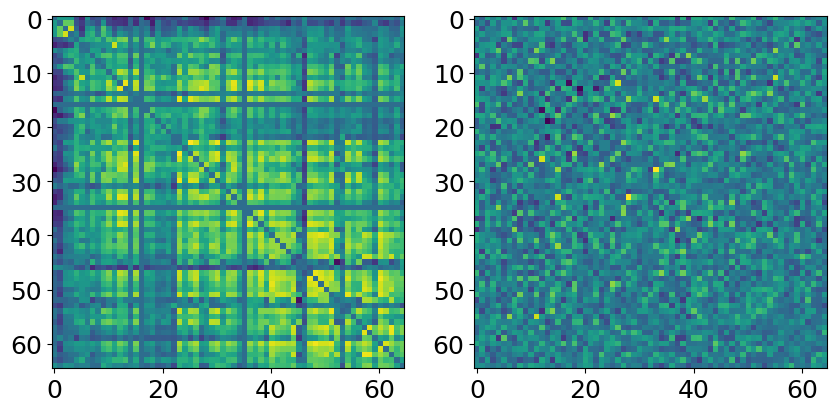

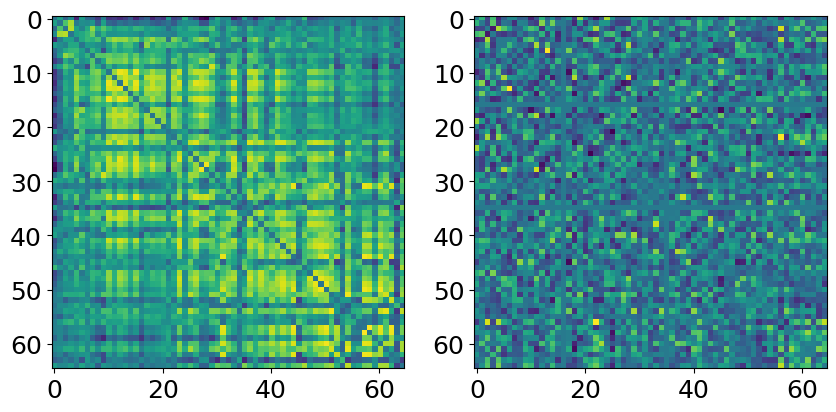

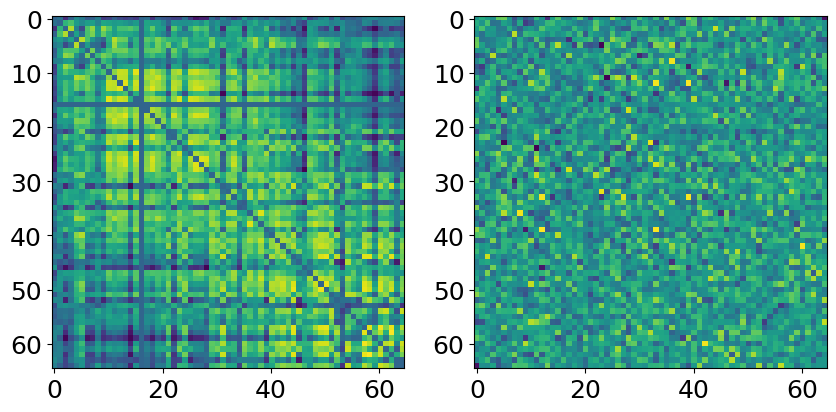

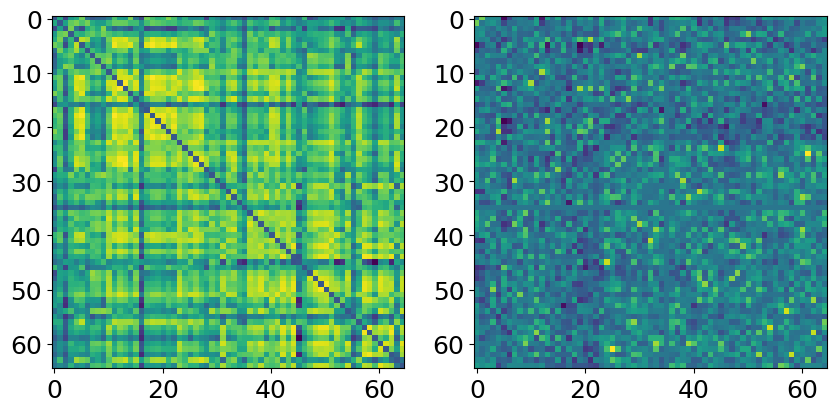

...

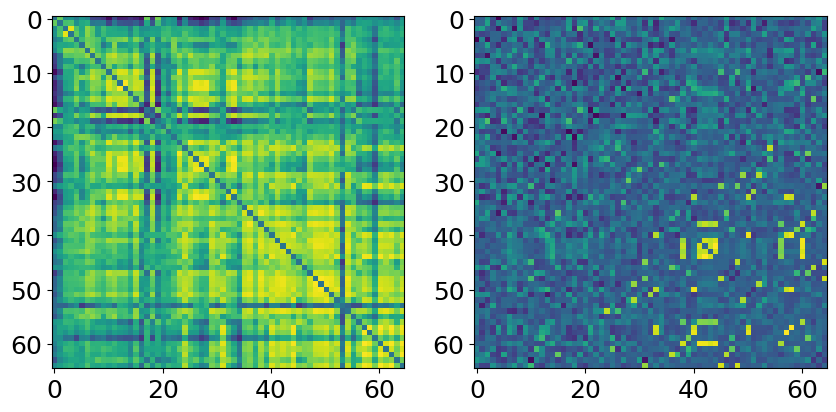

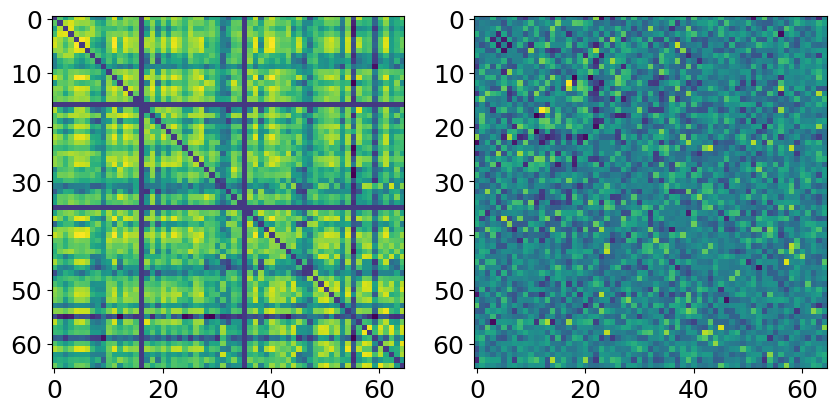

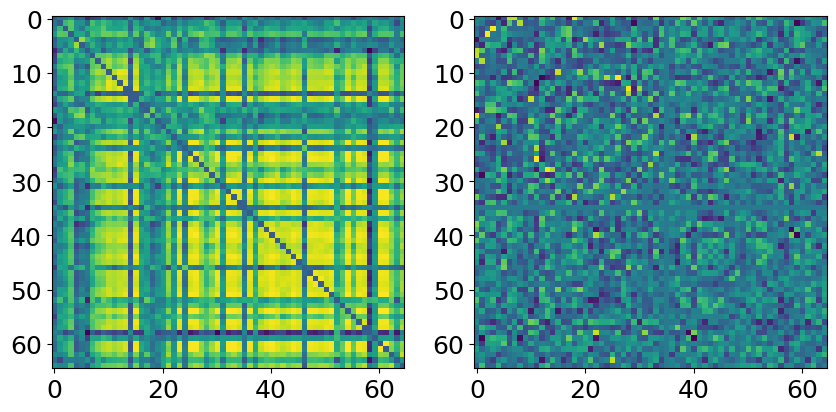

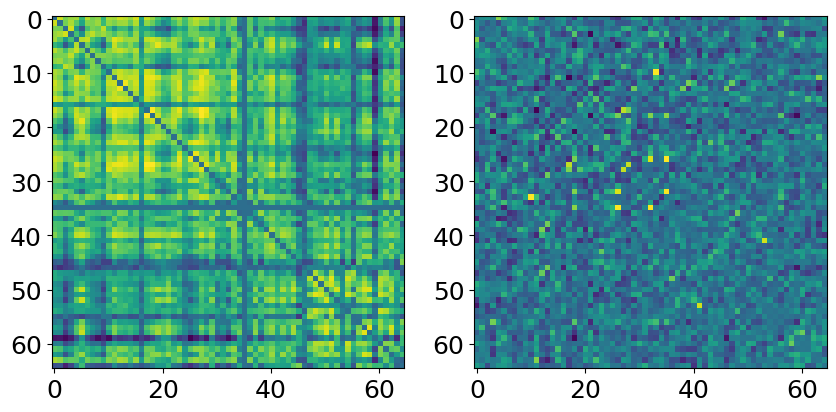

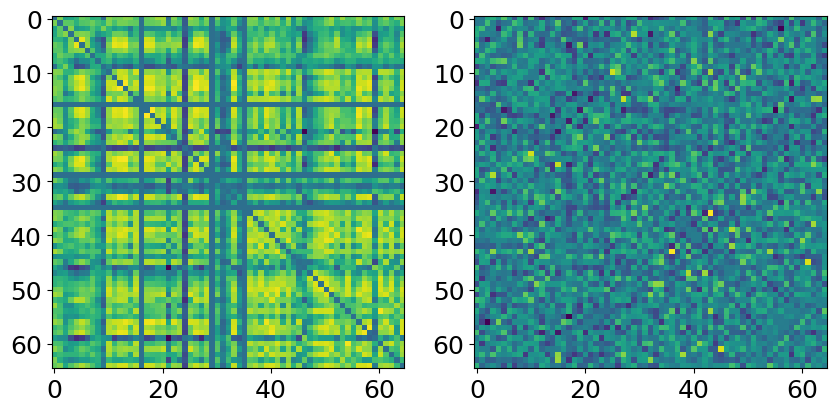

In [49]:
for i in range(len(random_matrices)):
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(corr_matrices[i])
    ax[1].imshow(random_matrices[i])

#### Plotting distributions

In [50]:
bins = np.linspace(0, 1, 30)
h1 = plt.hist(fish_correlations[np.triu_indices(22, 1)], bins=bins, color='black', density=True)
h2 = plt.hist(np.concatenate(random_correlation_values1), bins=bins, color='green', density=True, alpha=0.5)
h3 = plt.hist(np.concatenate(random_correlation_values2), bins=bins, color='green', density=True, alpha=0.5)
plt.close()

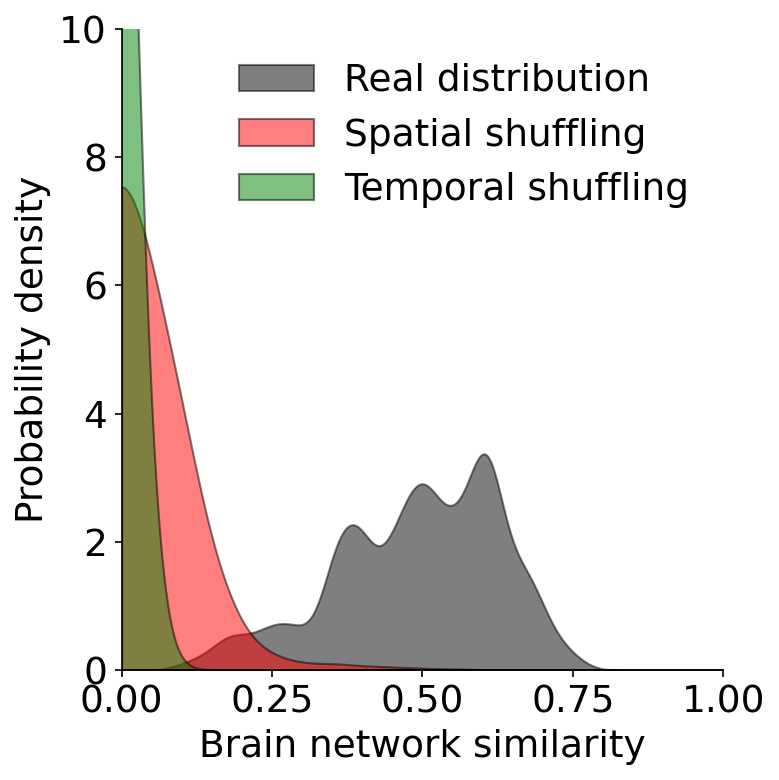

In [51]:
fig, ax = plt.subplots(figsize=(5, 5), dpi=150)

sigma = 20
y1 = gaussian_filter1d(interpolate_signal(h1[0], 1000), sigma)
x1 = interpolate_signal(h1[1], 1000)
y2 = gaussian_filter1d(interpolate_signal(h2[0], 1000), sigma)
x2 = interpolate_signal(h2[1], 1000)
y3 = gaussian_filter1d(interpolate_signal(h3[0], 1000), sigma)
x3 = interpolate_signal(h3[1], 1000)

plt.fill_between(x1, 0, y1, color='black', edgecolor='black', label='Real distribution', alpha=0.5)
plt.fill_between(x2, 0, y2, color='red', edgecolor='black', label='Spatial shuffling', alpha=0.5)
plt.fill_between(x3, 0, y3, color='green', edgecolor='black', label='Temporal shuffling', alpha=0.5)
plt.legend(frameon=False)

ax.spines[['top', 'right']].set_visible(False)
plt.xlabel('Brain network similarity')
plt.ylabel('Probability density')
plt.xticks([0, 0.25, 0.5, 0.75, 1])
plt.xlim([0, 1])
plt.ylim([0, 10])
#plt.yscale('log')
#plt.xlim([0.2, 1])
plt.tight_layout(pad=0)
plt.show()


In [52]:
np.percentile(random_correlation_values1, 99.9)

0.5008343209995753

# Single fish networks

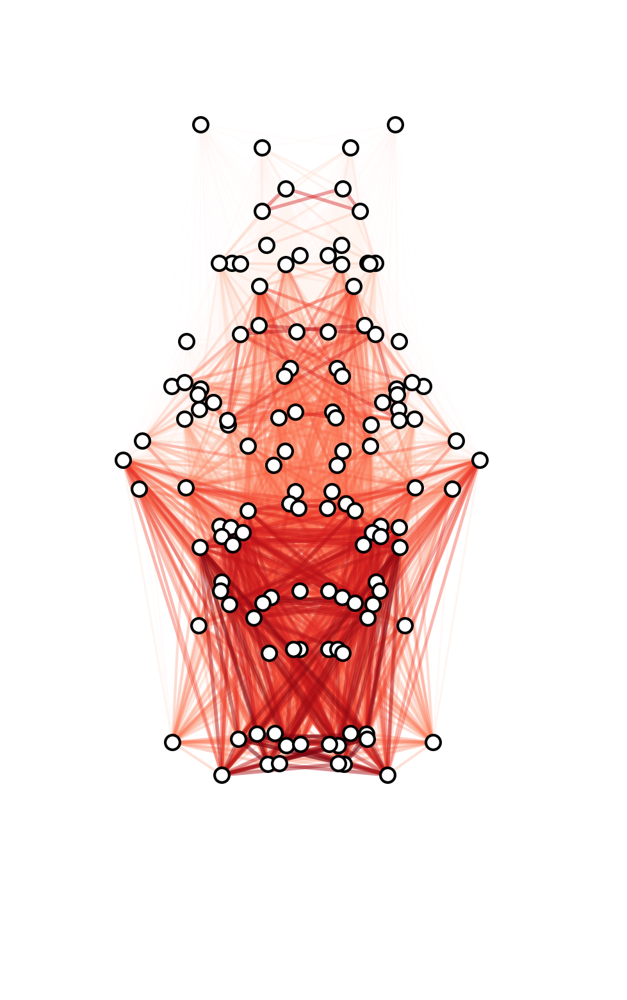

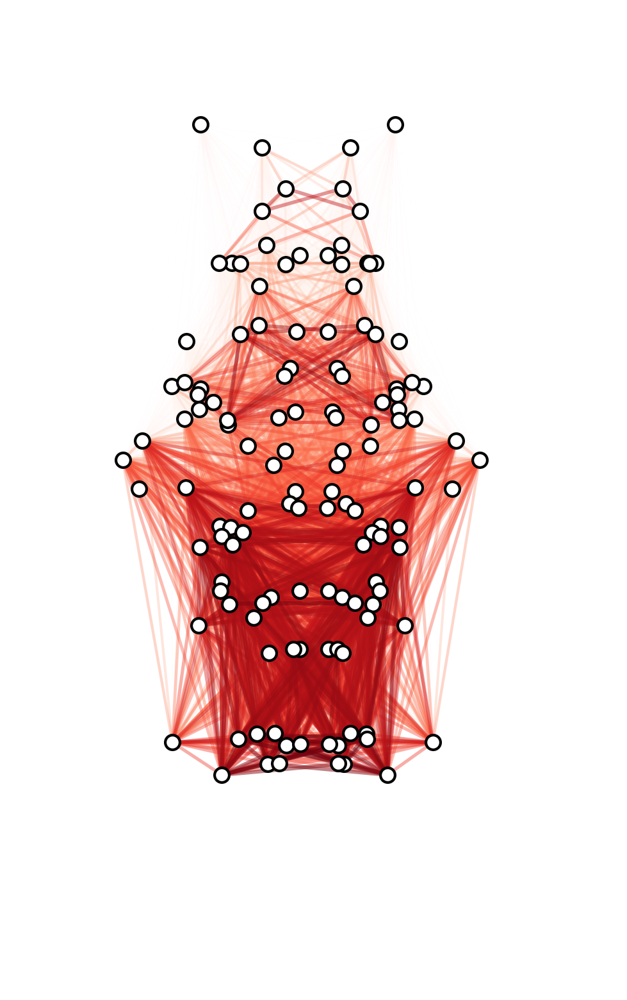

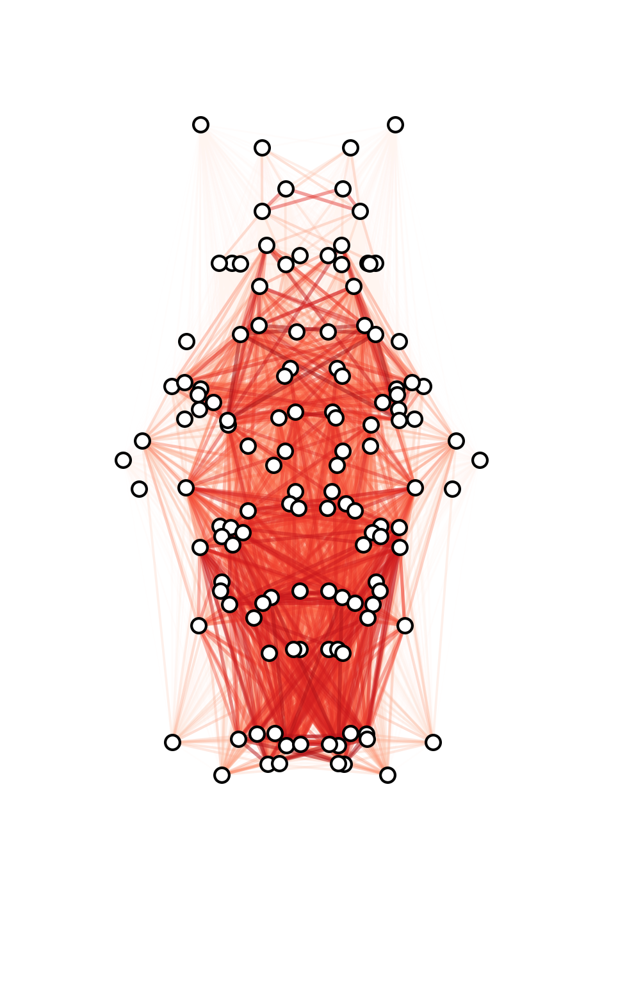

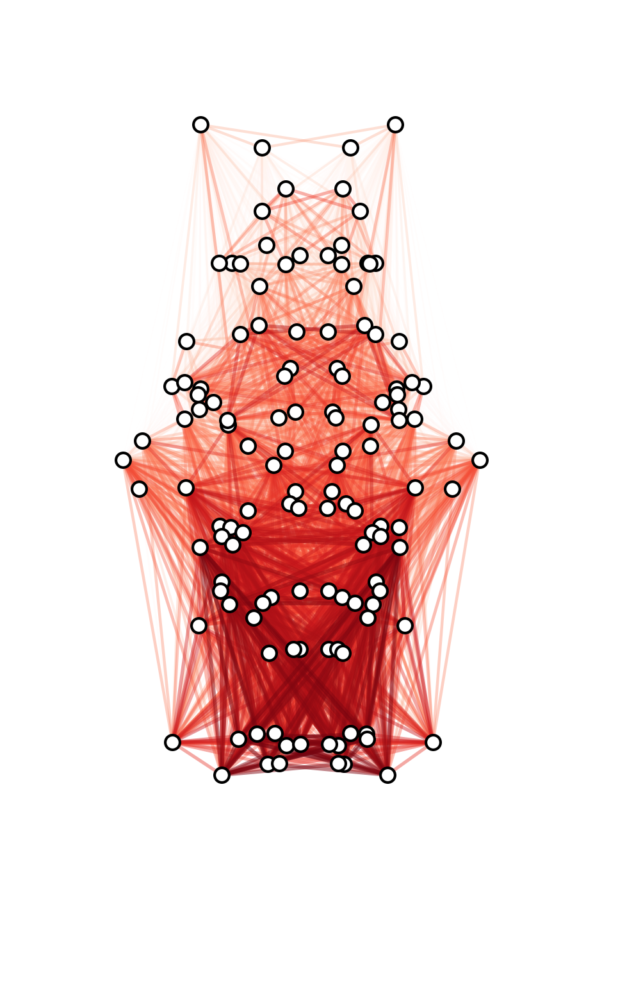

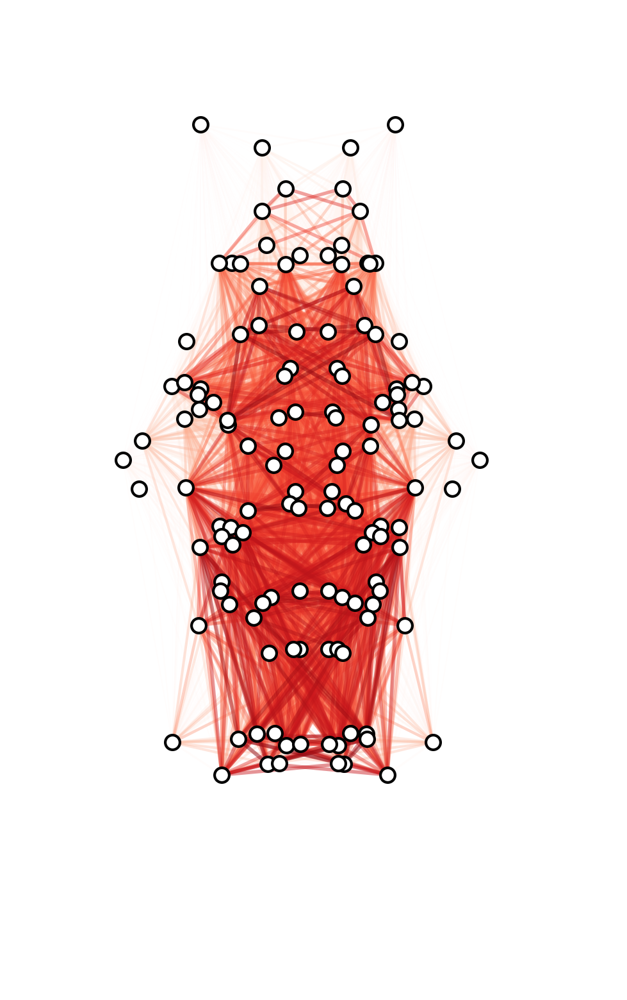

...

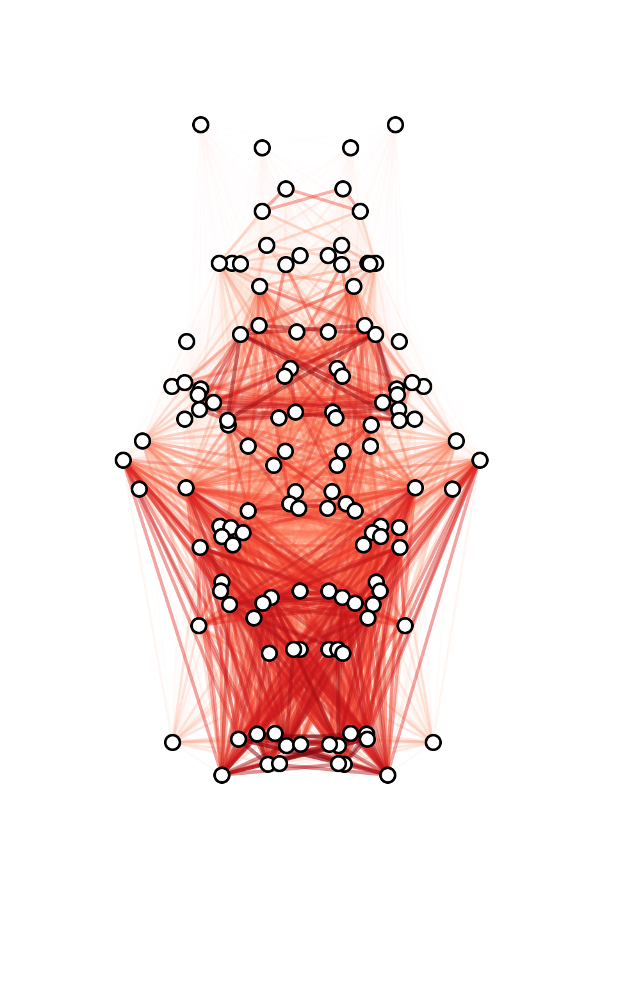

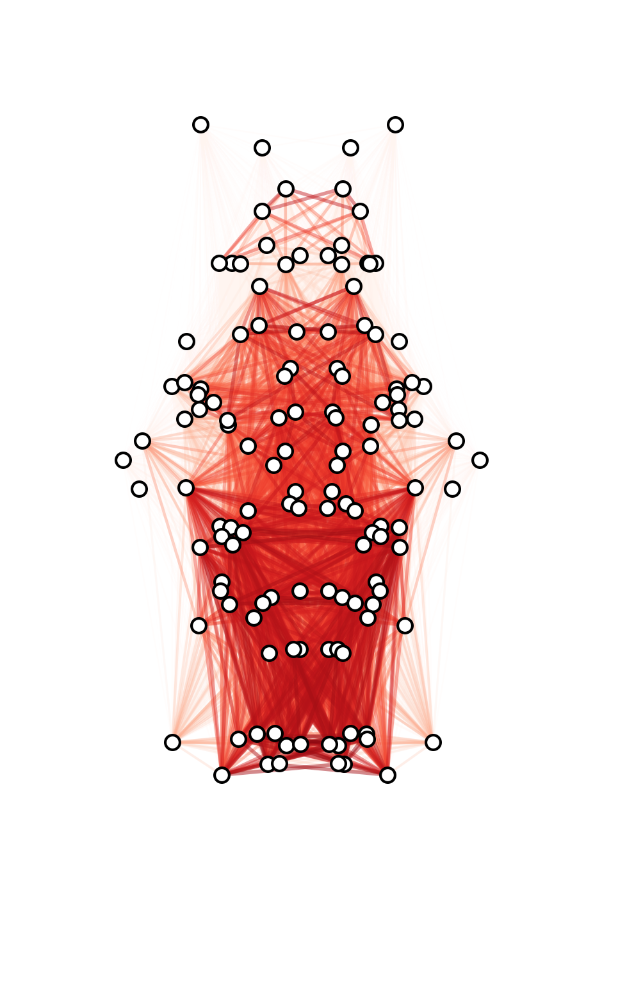

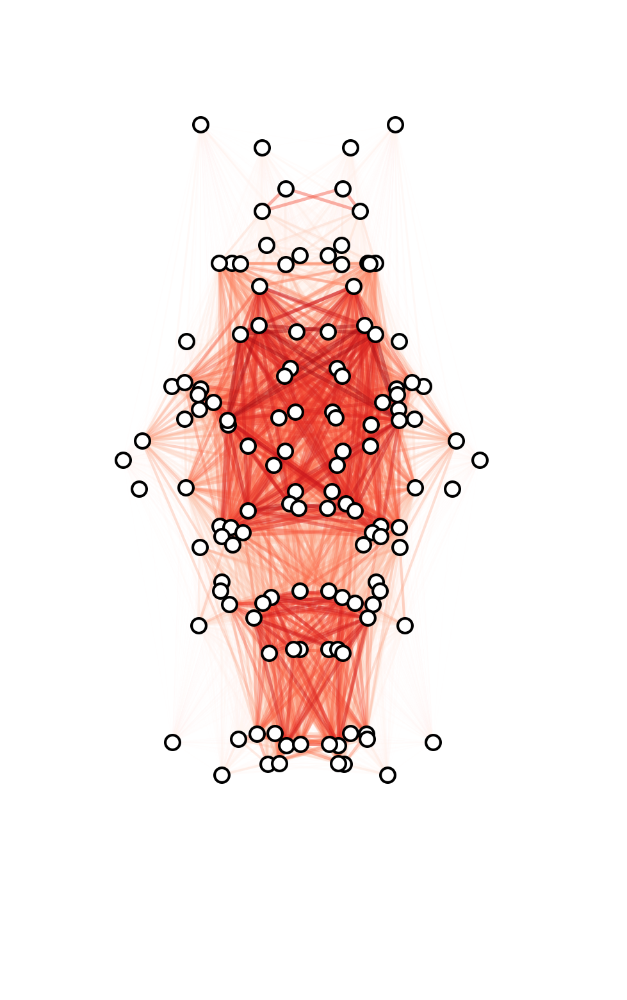

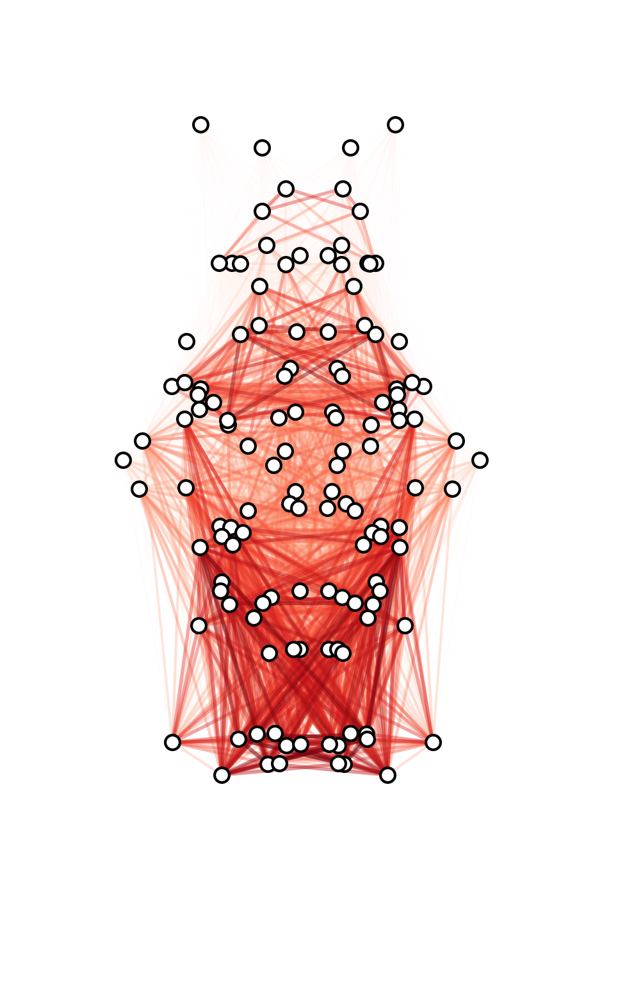

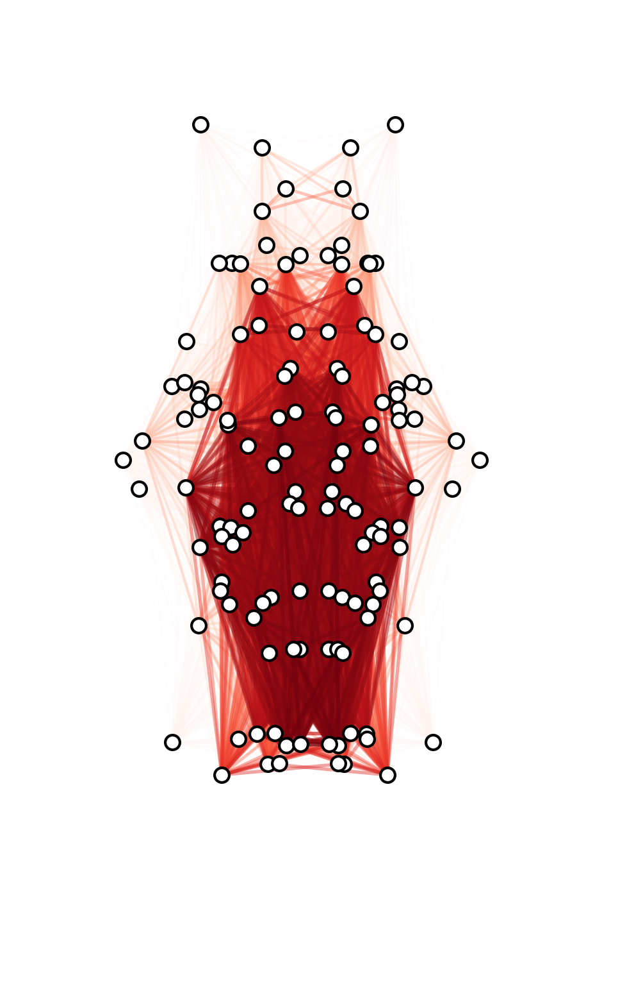

In [272]:
percentile = 50

for i in range(len(corr_matrices)):
    ratio = atlas.XYprojection.shape[0] / atlas.XZprojection.shape[1]
    fig, ax = plt.subplots(figsize=(5, 5 * ratio), dpi=300)
    plt.imshow(atlas.XYprojection, cmap='binary', alpha=0)
    draw_graph(ax, np.tile(corr_matrices[i], (2, 2)), region_centroids, percentile=0, s=30, edge_cmap='Reds', alpha=0.5, edge_vmin=0.5, edge_vmax=1)
    
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.savefig('Figures/figure1_network_fish{}.png'.format(i))
    plt.show()